<a href="https://colab.research.google.com/github/uol-mediaprocessing/group-projects-sudoku-solver/blob/master/main_transformation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Preamble

In [0]:
import cv2 as cv
import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [3]:
!wget https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/definitions/common.py -O "common.py"
from common import *

--2020-01-16 12:29:50--  https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/definitions/common.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4100 (4.0K) [text/plain]
Saving to: ‘common.py’

common.py           100%[===================>]   4.00K  --.-KB/s    in 0s      

2020-01-16 12:29:50 (76.0 MB/s) - ‘common.py’ saved [4100/4100]



In [4]:
!wget https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/definitions/transformation.py -O "transformation.py"
from transformation import *

--2020-01-16 12:29:58--  https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/definitions/transformation.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1181 (1.2K) [text/plain]
Saving to: ‘transformation.py’

transformation.py   100%[===================>]   1.15K  --.-KB/s    in 0s      

2020-01-16 12:29:58 (207 MB/s) - ‘transformation.py’ saved [1181/1181]



In [5]:
!cp "./drive/My Drive/sudoku_acquisition_output.bz2" "./sudoku_acquisition_output.bz2"
acquisition_output = pd.read_pickle("./sudoku_acquisition_output.bz2")
acquisition_output

,input_image,input_digits,input_classes,training
input_filename,,,,
./v2_train/image169.jpg,"[[[164, 161, 118], [164, 161, 118], [164, 161,...","[[8, 3, 0, 0, 0, 7, 9, 0, 0], [0, 0, 0, 0, 3, ...","[[1, 1, 0, 0, 0, 1, 1, 0, 0], [0, 0, 0, 0, 1, ...",False
./v2_train/image72.jpg,"[[[169, 168, 147], [169, 168, 147], [169, 168,...","[[0, 7, 1, 9, 0, 2, 0, 5, 0], [0, 0, 0, 0, 0, ...","[[0, 1, 1, 1, 0, 1, 0, 1, 0], [0, 0, 0, 0, 0, ...",True
./v2_train/image1066.jpg,"[[[146, 143, 147], [146, 143, 147], [147, 145,...","[[1, 0, 0, 0, 0, 0, 0, 0, 0], [2, 6, 0, 1, 5, ...","[[1, 0, 0, 0, 0, 0, 0, 0, 0], [1, 1, 0, 1, 1, ...",False
./v2_train/image1087.jpg,"[[[47, 42, 43], [48, 44, 41], [46, 45, 42], [4...","[[0, 0, 2, 0, 0, 9, 1, 0, 5], [0, 8, 0, 7, 0, ...","[[0, 0, 1, 0, 0, 1, 1, 0, 1], [0, 1, 0, 1, 0, ...",True
./v2_train/image204.jpg,"[[[154, 146, 93], [158, 150, 103], [163, 154, ...","[[0, 1, 3, 0, 0, 0, 0, 0, 0], [0, 0, 6, 0, 4, ...","[[0, 1, 1, 0, 0, 0, 0, 0, 0], [0, 0, 1, 0, 1, ...",False
...,...,...,...,...
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165358878.jpg,"[[[77, 75, 78], [77, 75, 78], [78, 76, 79], [7...","[[2, 4, 7, 9, 9, 4, 7, 6, 1], [8, 7, 6, 2, 6, ...","[[2, 2, 2, 2, 2, 2, 1, 2, 1], [1, 2, 2, 2, 2, ...",True
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165329872.jpg,"[[[133, 127, 105], [132, 126, 104], [133, 127,...","[[2, 4, 7, 9, 9, 4, 7, 6, 1], [8, 7, 6, 2, 6, ...","[[2, 2, 2, 2, 2, 2, 1, 2, 1], [1, 2, 2, 2, 2, ...",True
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165402379.jpg,"[[[51, 51, 51], [49, 49, 49], [46, 46, 46], [4...","[[2, 4, 7, 9, 9, 4, 7, 6, 1], [8, 7, 6, 2, 6, ...","[[2, 2, 2, 2, 2, 2, 1, 2, 1], [1, 2, 2, 2, 2, ...",True


In [6]:
!cp "./drive/My Drive/sudoku_detection_output.bz2" "./sudoku_detection_output.bz2"
detection_output = pd.read_pickle("./sudoku_detection_output.bz2")
detection_output

,detected_contour,detected_contour_image
input_filename,,
./v2_train/image1066.jpg,"[[[34, 139]], [[30, 377]], [[469, 377]], [[454...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
./v2_train/image1087.jpg,"[[[56, 79]], [[51, 374]], [[475, 368]], [[446,...","[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ..."
./v2_train/image204.jpg,"[[[399, 65]], [[97, 72]], [[95, 474]], [[407, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
./v2_train/image1075.jpg,"[[[457, 112]], [[58, 117]], [[56, 427]], [[479...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
./v2_train/image1078.jpg,"[[[422, 118]], [[62, 123]], [[53, 395]], [[430...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
...,...,...
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165410544.jpg,"[[[386, 160]], [[117, 163]], [[94, 373]], [[41...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165338808.jpg,"[[[4, 264]], [[294, 427]], [[478, 238]], [[229...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165329872.jpg,"[[[396, 152]], [[108, 154]], [[86, 379]], [[42...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."


In [7]:
dataset = acquisition_output.join(detection_output, how="inner")
dataset

,input_image,input_digits,input_classes,training,detected_contour,detected_contour_image
input_filename,,,,,,
./v2_train/image1066.jpg,"[[[146, 143, 147], [146, 143, 147], [147, 145,...","[[1, 0, 0, 0, 0, 0, 0, 0, 0], [2, 6, 0, 1, 5, ...","[[1, 0, 0, 0, 0, 0, 0, 0, 0], [1, 1, 0, 1, 1, ...",False,"[[[34, 139]], [[30, 377]], [[469, 377]], [[454...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
./v2_train/image1087.jpg,"[[[47, 42, 43], [48, 44, 41], [46, 45, 42], [4...","[[0, 0, 2, 0, 0, 9, 1, 0, 5], [0, 8, 0, 7, 0, ...","[[0, 0, 1, 0, 0, 1, 1, 0, 1], [0, 1, 0, 1, 0, ...",True,"[[[56, 79]], [[51, 374]], [[475, 368]], [[446,...","[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ..."
./v2_train/image204.jpg,"[[[154, 146, 93], [158, 150, 103], [163, 154, ...","[[0, 1, 3, 0, 0, 0, 0, 0, 0], [0, 0, 6, 0, 4, ...","[[0, 1, 1, 0, 0, 0, 0, 0, 0], [0, 0, 1, 0, 1, ...",False,"[[[399, 65]], [[97, 72]], [[95, 474]], [[407, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
./v2_train/image1075.jpg,"[[[182, 170, 154], [183, 171, 155], [183, 171,...","[[3, 0, 0, 0, 9, 0, 0, 0, 2], [0, 1, 0, 0, 0, ...","[[1, 0, 0, 0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, ...",True,"[[[457, 112]], [[58, 117]], [[56, 427]], [[479...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
./v2_train/image1078.jpg,"[[[166, 166, 158], [172, 168, 161], [174, 170,...","[[0, 0, 4, 8, 0, 9, 0, 0, 0], [0, 3, 0, 0, 4, ...","[[0, 0, 1, 1, 0, 1, 0, 0, 0], [0, 1, 0, 0, 1, ...",True,"[[[422, 118]], [[62, 123]], [[53, 395]], [[430...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
...,...,...,...,...,...,...
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165410544.jpg,"[[[41, 43, 40], [46, 48, 45], [47, 49, 47], [4...","[[2, 4, 7, 9, 9, 4, 7, 6, 1], [8, 7, 6, 2, 6, ...","[[2, 2, 2, 2, 2, 2, 1, 2, 1], [1, 2, 2, 2, 2, ...",True,"[[[386, 160]], [[117, 163]], [[94, 373]], [[41...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165338808.jpg,"[[[66, 61, 59], [67, 63, 60], [66, 63, 58], [6...","[[2, 4, 7, 9, 9, 4, 7, 6, 1], [8, 7, 6, 2, 6, ...","[[2, 2, 2, 2, 2, 2, 1, 2, 1], [1, 2, 2, 2, 2, ...",True,"[[[4, 264]], [[294, 427]], [[478, 238]], [[229...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165329872.jpg,"[[[133, 127, 105], [132, 126, 104], [133, 127,...","[[2, 4, 7, 9, 9, 4, 7, 6, 1], [8, 7, 6, 2, 6, ...","[[2, 2, 2, 2, 2, 2, 1, 2, 1], [1, 2, 2, 2, 2, ...",True,"[[[396, 152]], [[108, 154]], [[86, 379]], [[42...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."


# Introduction
Because we now know all four corner points of the Sudoku grid (which are stored in `detection_output`), we can apply a transformation to the input images in `acquistion_output`, removing distortions caused by the camera's perspective.
This transformation is done by first calculating a transformation matrix using OpenCV's `getPerspectiveTransform(...)` and then applying this transformation to our source image using `warpPerspective(...)`.


# Sorting of contour vertices

The method `getPerspectiveTransform(...)` requires us to define a list of source points $s_1, s_2, s_3, s_4$ that are mapped to a list of target points $t_1, t_2, t_3, t_4$.
For this mapping the order of the points is very important.
If the orders don't match, the resulting image could be rotated by 90°, 180° or 270°.
The output of OpenCV's `findContours(...)` method however does not guarantee a specific order of vertices.
For this reason, we define a method [`sort_corners(...)`](https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/definitions/transformation.py) that sorts the rectangle's corners in a deterministic way:

- The top-left corner ($s_1$ and $t_1$ respectively) has the smallest sum of x + y values
- The bottom-left corner ($s_2$ and $t_2$ respectively) has the largest difference of y - x values
- The bottom-right corner ($s_3$ and $t_3$ respectively) has the largest sum of x + y values
- The top-right corner ($s_4$ and $t_4$ respectively) has the smallest difference of y - x values

The basic idea for this process came from [this site](https://www.pyimagesearch.com/2014/08/25/4-point-opencv-getperspective-transform-example/).

In [14]:
dataset["transform_contour_source"] = [sort_contour(x) for x in dataset["detected_contour"]]
dataset["transform_contour_source"]

input_filename
./v2_train/image1066.jpg                                                  [[34, 139], [30, 377], [469, 377], [454, 138]]
./v2_train/image1087.jpg                                                    [[56, 79], [51, 374], [475, 368], [446, 79]]
./v2_train/image204.jpg                                                     [[97, 72], [95, 474], [407, 477], [399, 65]]
./v2_train/image1075.jpg                                                  [[58, 117], [56, 427], [479, 418], [457, 112]]
./v2_train/image1078.jpg                                                  [[62, 123], [53, 395], [430, 392], [422, 118]]
                                                                                              ...                       
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165410544.jpg    [[117, 163], [94, 373], [410, 370], [386, 160]]
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165338808.jpg       [[4, 264], [4, 264], [294, 427], [478, 238]]
./sudoku_dataset_

The following visualization draws all detected and sorted corners $s_1, s_2, s_3, s_4$ of some example Sudoku grids using the colors *red*, *green*, *blue* and *yellow* respectively.

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


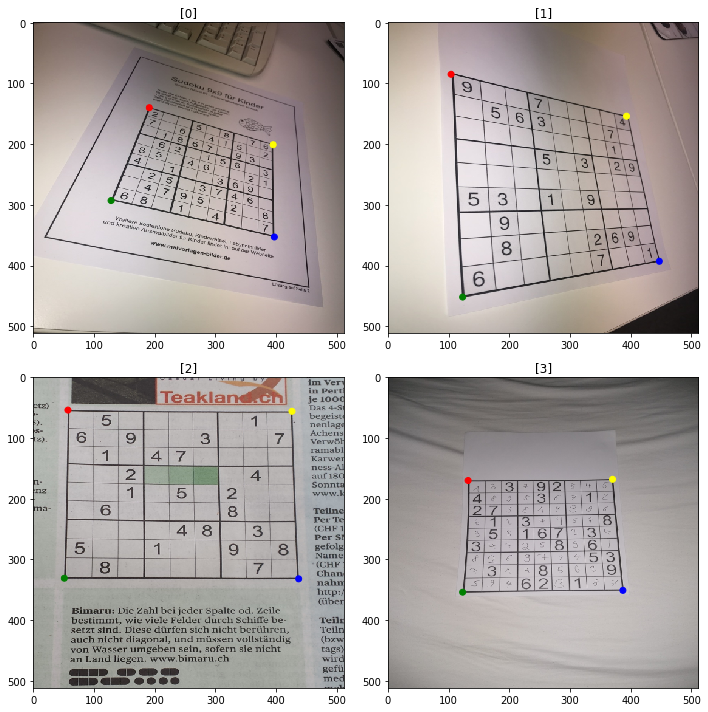

In [15]:
examples = dataset.sample(n=4)
plt.figure(figsize=(10, 10))
show_images(examples["input_image"], figure=False)
for i in range(4):
  plt.subplot(2, 2, i + 1)  # this is technically a hack depending on deprecated behaviour
  points = examples["transform_contour_source"][i]
  points_x, points_y = zip(*points)
  plt.scatter(points_x, points_y, c=["red", "green", "blue", "yellow"])
plt.tight_layout()
plt.show()

# Defintion of target vertices

For the following transformations we have to define the corner points $t_1, t_2, t_3, t_4$ of our target square.
Their exact values depend on the square side length.
This could be done in a static way, e. g. scale every image of a Sudoku grid to a 1024x1024 rectangle, or we choose our target dimensions based on each individual analyzed image.
That way we retain as much spatial resolution and therefore information as possible.
We decided to use the detected contour's circumfrence as a reference for our target square's side length.

The side length $l$ will be calculated as follows: 
$$l=\frac{1}{4}\cdot\text{circumfrence of contour}$$

This calculation is implemented by the [`get_side_length(...)`](https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/definitions/transformation.py) method.

In [16]:
dataset["transform_side_length"] = [get_side_length(x) for x in dataset["transform_contour_source"]]
dataset["transform_side_length"]

input_filename
./v2_train/image1066.jpg                                                 334
./v2_train/image1087.jpg                                                 349
./v2_train/image204.jpg                                                  357
./v2_train/image1075.jpg                                                 359
./v2_train/image1078.jpg                                                 320
                                                                        ... 
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165410544.jpg    251
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165338808.jpg    267
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165329872.jpg    269
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165402379.jpg    228
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165333373.jpg    243
Name: transform_side_length, Length: 276, dtype: int64

As we now know the side length of our target square, we can construct the list of target points $t_1, t_2, t_3, t_4$ the source points $s_1, s_2, s_3, s_4$ are mapped to.
These target points correspond to the four corner points of a square:

$$t_1=(0, 0),\quad t_2=(0, l),\quad t_3=(l, l),\quad t_4=(l, 0)$$

They are constructed by the [`get_target_contour(...)`](https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/definitions/transformation.py) method.



In [17]:
dataset["transform_contour_target"] = [get_target_contour(x) for x in dataset["transform_side_length"]] 
dataset["transform_contour_target"]

input_filename
./v2_train/image1066.jpg                                                 [[0, 0], [0, 334], [334, 334], [334, 0]]
./v2_train/image1087.jpg                                                 [[0, 0], [0, 349], [349, 349], [349, 0]]
./v2_train/image204.jpg                                                  [[0, 0], [0, 357], [357, 357], [357, 0]]
./v2_train/image1075.jpg                                                 [[0, 0], [0, 359], [359, 359], [359, 0]]
./v2_train/image1078.jpg                                                 [[0, 0], [0, 320], [320, 320], [320, 0]]
                                                                                           ...                   
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165410544.jpg    [[0, 0], [0, 251], [251, 251], [251, 0]]
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165338808.jpg    [[0, 0], [0, 267], [267, 267], [267, 0]]
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165329872.jpg    

# Computation of transformation matrix

From the list of sorted source contour corner points and the respective target points we can calculate the necessary linear transformation $M$ that warps the source images in the desired way, so that the following is true:

$$\forall i\in{1,2,3,4}: M \cdot s_1 = t_1$$

This matrix is calculated within our [get_transformation(...)](https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/definitions/transformation.py) method which internally delegates this task to OpenCV's `getPerspectiveTransform(...)` method.

In [18]:
dataset["transform_matrix"] = [get_transformation(x, y) for x, y in zip(dataset["transform_contour_source"], dataset["transform_contour_target"])]
dataset["transform_matrix"]

input_filename
./v2_train/image1066.jpg                                                 [[0.8205270679331066, 0.013790370889632036, -2...
./v2_train/image1087.jpg                                                 [[0.8969706083700217, 0.01520289166728851, -51...
./v2_train/image204.jpg                                                  [[1.228503379336248, 0.006111957111125652, -11...
./v2_train/image1075.jpg                                                 [[0.9091851228978102, 0.00586571047030846, -53...
./v2_train/image1078.jpg                                                 [[0.9172609330645485, 0.030350545579341717, -6...
                                                                                               ...                        
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165410544.jpg    [[1.0857963643501938, 0.11892055419073555, -14...
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165338808.jpg    [[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, ...
.

# Application of transformation matrix

The resulting transformation matrix can in turn be applied to the source image using [`apply_transformation(...)`](https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/definitions/transformation.py) which invokes OpenCV's `warpPerspective(...)` method.
Our source images now look like they have been shot straight from above.
Note however, that depending on how the Sudoku grid was oriented within the input image, the output image may be rotated. 

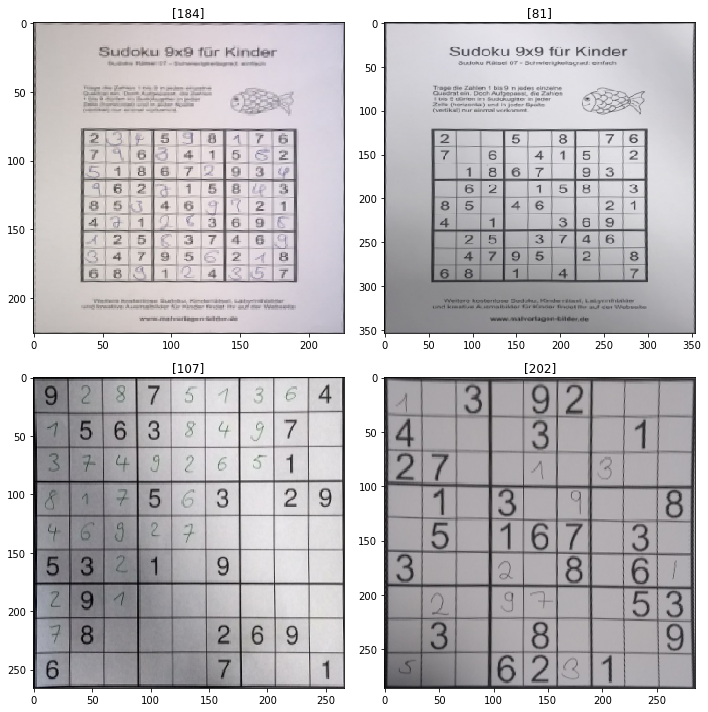

In [20]:
dataset["transform_image"] = [apply_transformation(*x) for x in zip(dataset["input_image"], dataset["transform_matrix"], dataset["transform_side_length"])]
show_images(dataset["transform_image"], n_samples=4)

# Filtering of results

Sudoku grids may be rotated or only partially detected.
These images cannot be further processed and are thus removed.
This filtering process is done in a manual way:
The set of all images in the dataset is split into chunks of 4 and each chunk is individually shown to the user. The user then has to decide which images were correctly detected and transformed.
Only the "good" images are then exported for further processing.

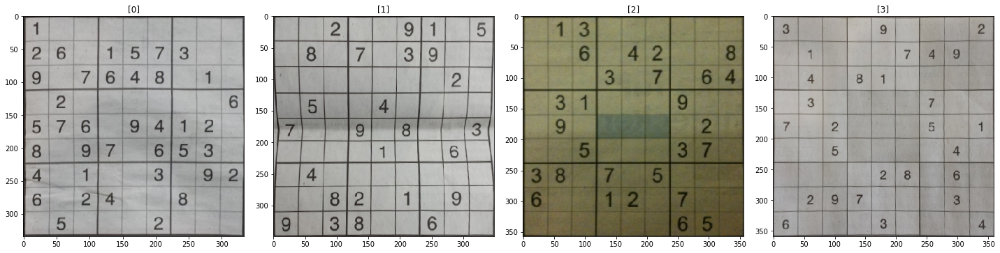

[1/69] Which of these images are valid?0123
[1/69] You have selected indices [0, 1, 2, 3] which are mapped to [0, 1, 2, 3]!


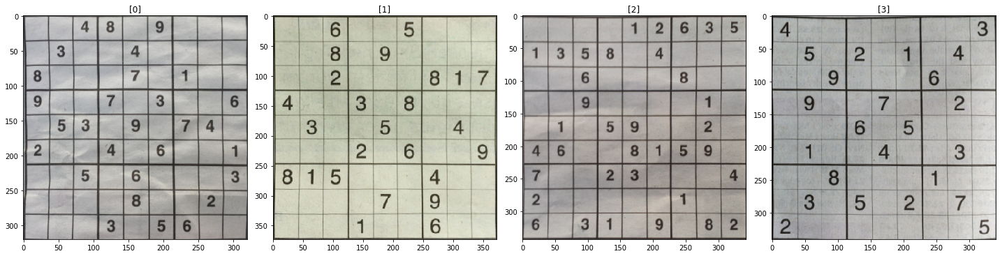

[2/69] Which of these images are valid?0123
[2/69] You have selected indices [0, 1, 2, 3] which are mapped to [4, 5, 6, 7]!


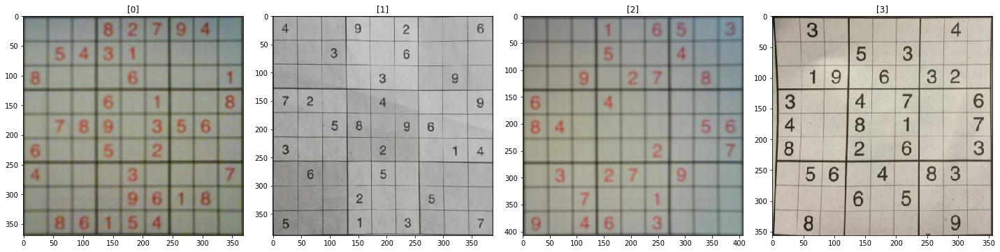

[3/69] Which of these images are valid?0123
[3/69] You have selected indices [0, 1, 2, 3] which are mapped to [8, 9, 10, 11]!


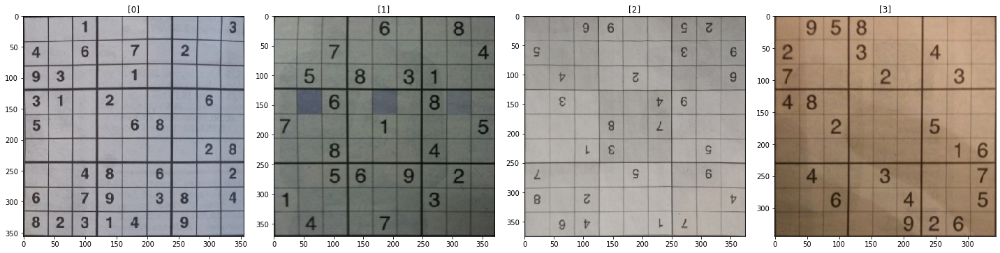

[4/69] Which of these images are valid?013
[4/69] You have selected indices [0, 1, 3] which are mapped to [12, 13, 15]!


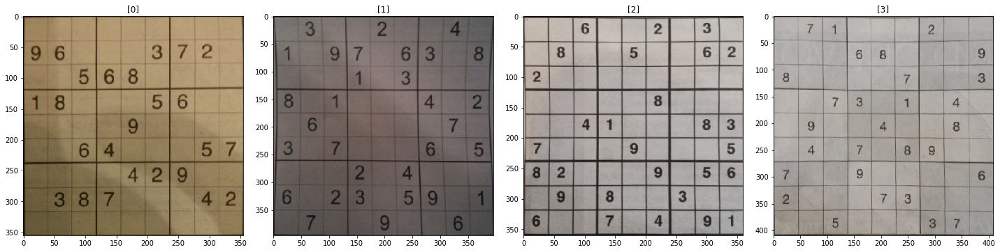

[5/69] Which of these images are valid?0123
[5/69] You have selected indices [0, 1, 2, 3] which are mapped to [16, 17, 18, 19]!


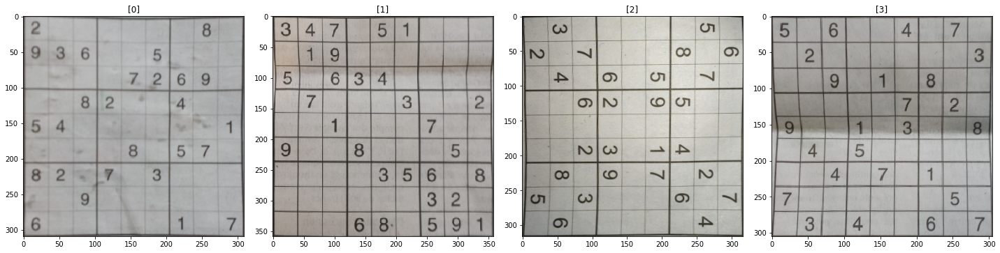

[6/69] Which of these images are valid?013
[6/69] You have selected indices [0, 1, 3] which are mapped to [20, 21, 23]!


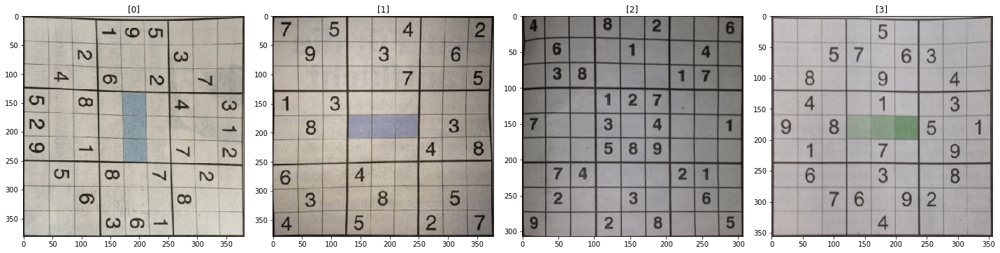

[7/69] Which of these images are valid?123
[7/69] You have selected indices [1, 2, 3] which are mapped to [25, 26, 27]!


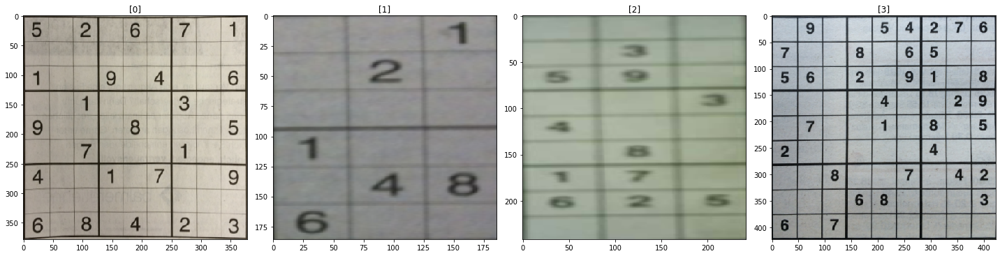

[8/69] Which of these images are valid?03
[8/69] You have selected indices [0, 3] which are mapped to [28, 31]!


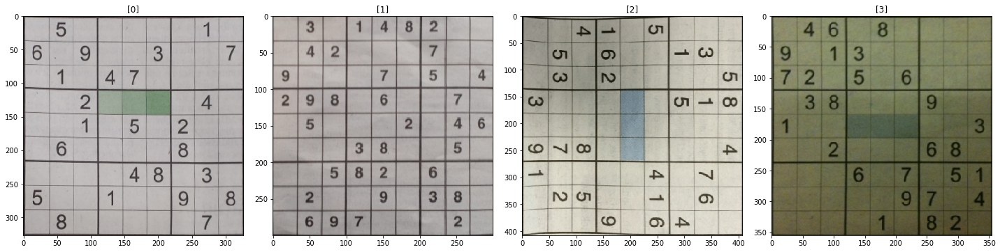

[9/69] Which of these images are valid?013
[9/69] You have selected indices [0, 1, 3] which are mapped to [32, 33, 35]!


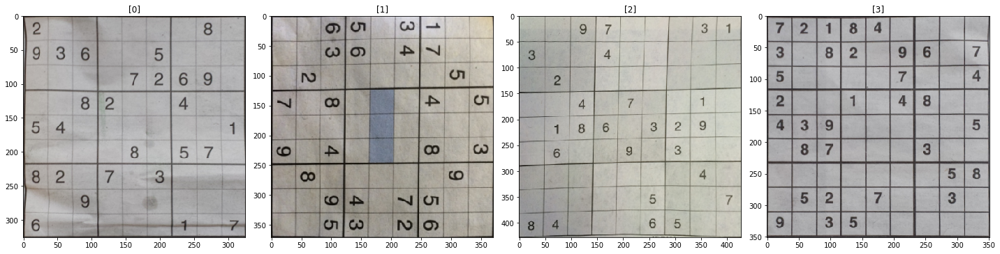

[10/69] Which of these images are valid?023
[10/69] You have selected indices [0, 2, 3] which are mapped to [36, 38, 39]!


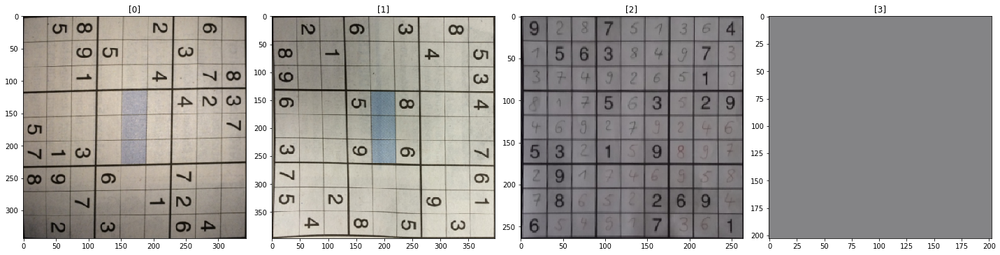

[11/69] Which of these images are valid?2
[11/69] You have selected indices [2] which are mapped to [42]!


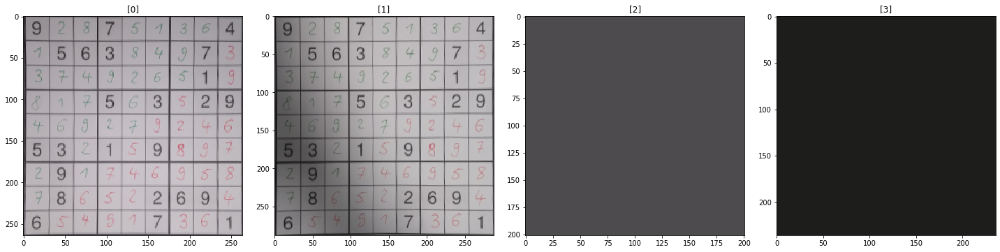

[12/69] Which of these images are valid?01
[12/69] You have selected indices [0, 1] which are mapped to [44, 45]!


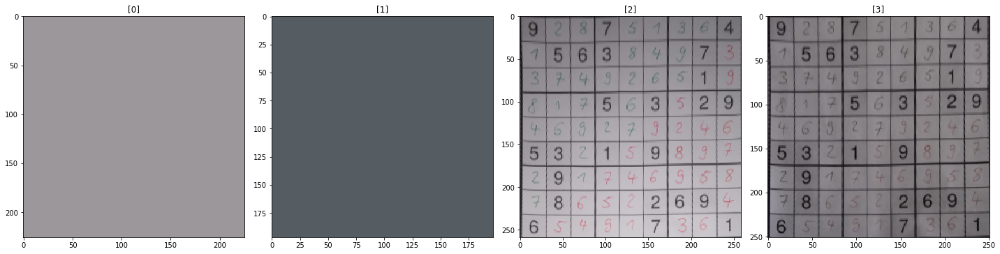

[13/69] Which of these images are valid?23
[13/69] You have selected indices [2, 3] which are mapped to [50, 51]!


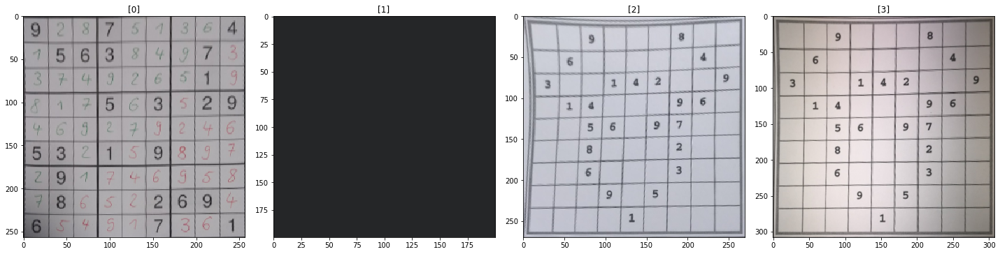

[14/69] Which of these images are valid?023
[14/69] You have selected indices [0, 2, 3] which are mapped to [52, 54, 55]!


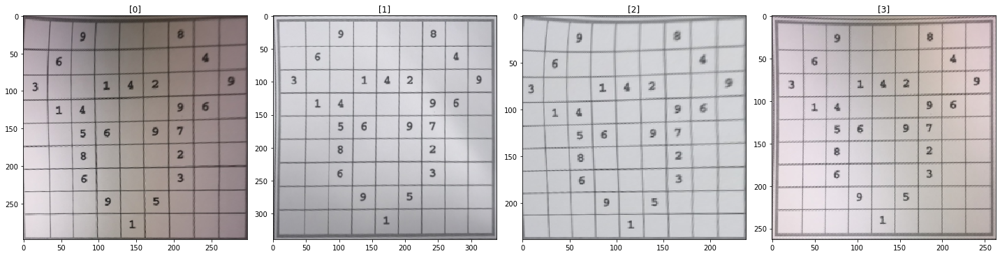

[15/69] Which of these images are valid?0123
[15/69] You have selected indices [0, 1, 2, 3] which are mapped to [56, 57, 58, 59]!


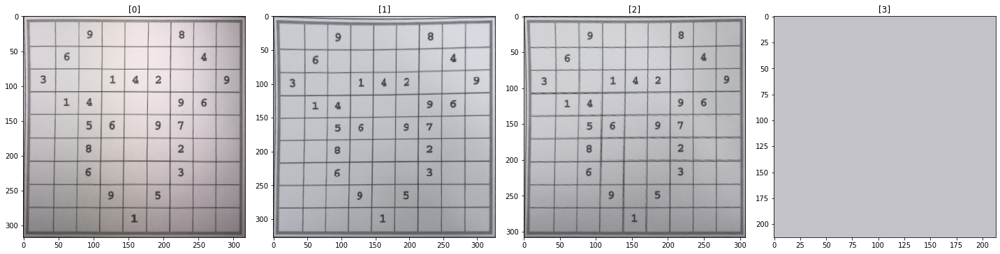

[16/69] Which of these images are valid?012
[16/69] You have selected indices [0, 1, 2] which are mapped to [60, 61, 62]!


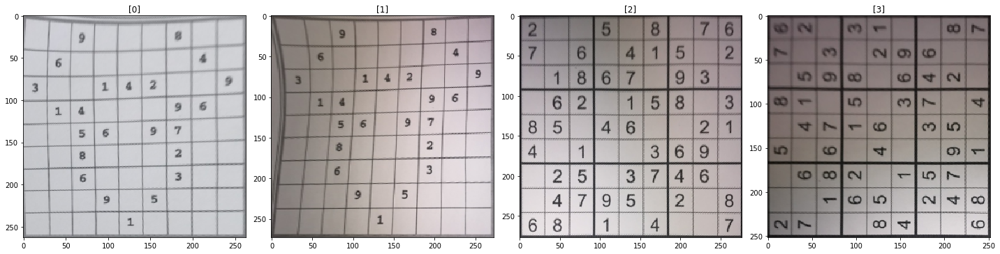

[17/69] Which of these images are valid?012
[17/69] You have selected indices [0, 1, 2] which are mapped to [64, 65, 66]!


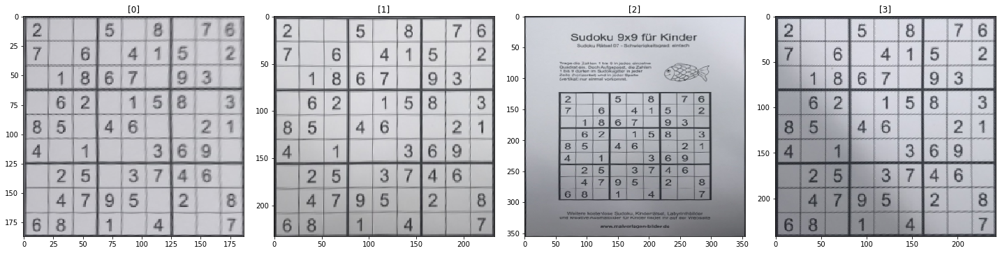

[18/69] Which of these images are valid?013
[18/69] You have selected indices [0, 1, 3] which are mapped to [68, 69, 71]!


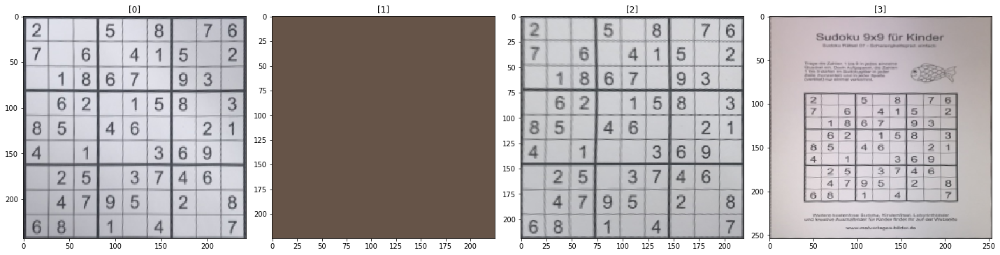

[19/69] Which of these images are valid?02
[19/69] You have selected indices [0, 2] which are mapped to [72, 74]!


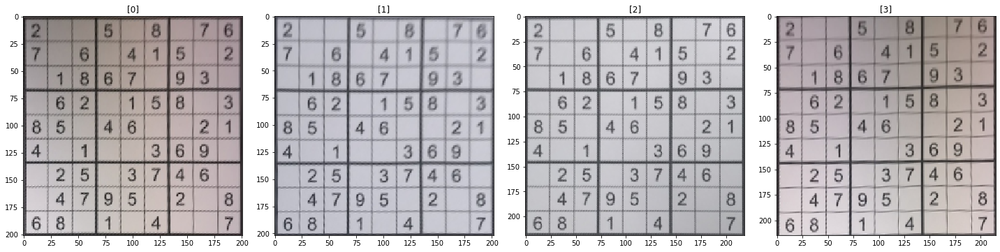

[20/69] Which of these images are valid?0123
[20/69] You have selected indices [0, 1, 2, 3] which are mapped to [76, 77, 78, 79]!


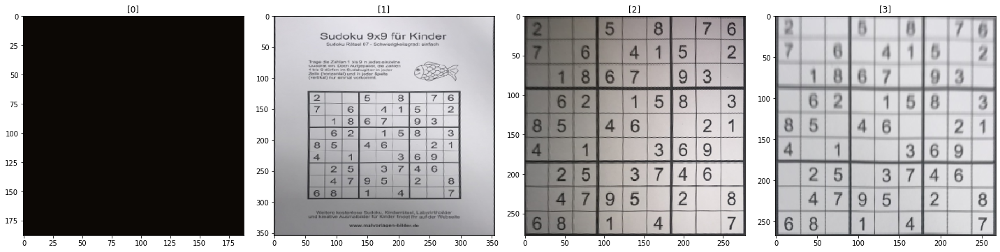

[21/69] Which of these images are valid?23
[21/69] You have selected indices [2, 3] which are mapped to [82, 83]!


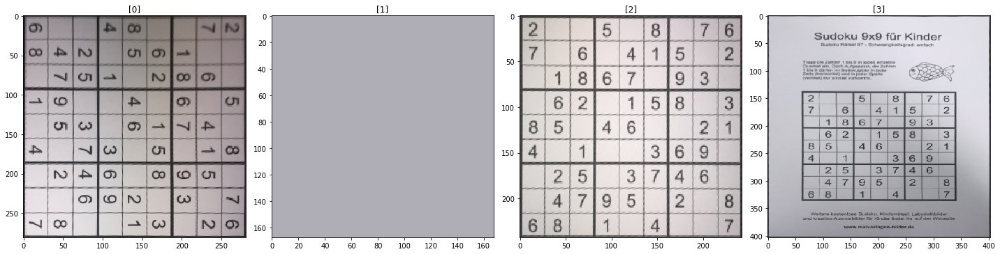

[22/69] Which of these images are valid?2
[22/69] You have selected indices [2] which are mapped to [86]!


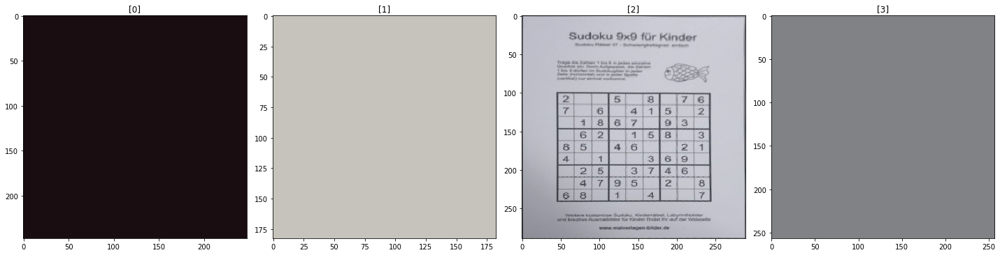

[23/69] Which of these images are valid?
[23/69] You have selected indices [] which are mapped to []!


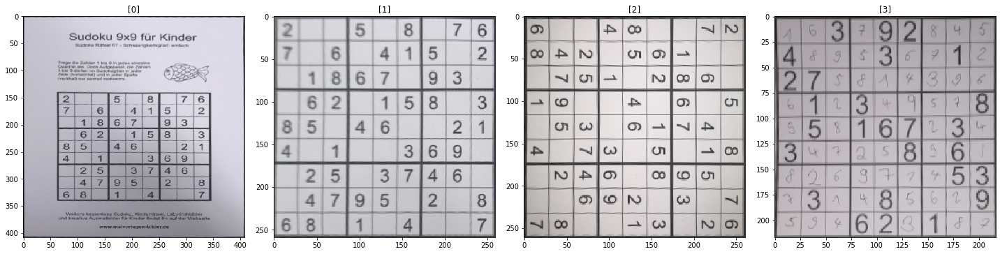

[24/69] Which of these images are valid?13
[24/69] You have selected indices [1, 3] which are mapped to [93, 95]!


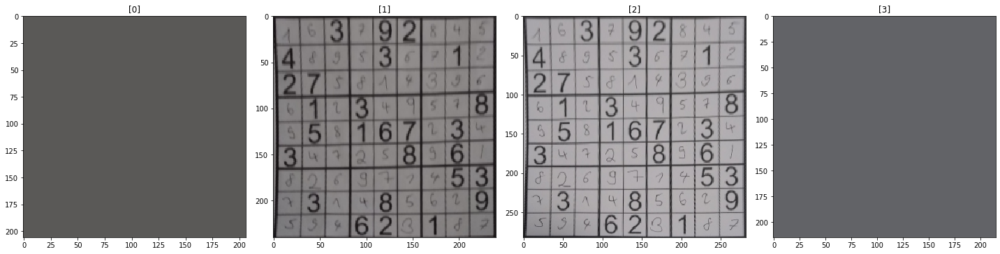

[25/69] Which of these images are valid?12
[25/69] You have selected indices [1, 2] which are mapped to [97, 98]!


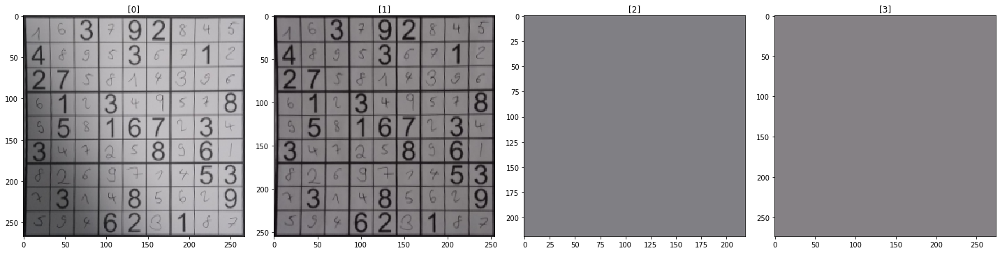

[26/69] Which of these images are valid?01
[26/69] You have selected indices [0, 1] which are mapped to [100, 101]!


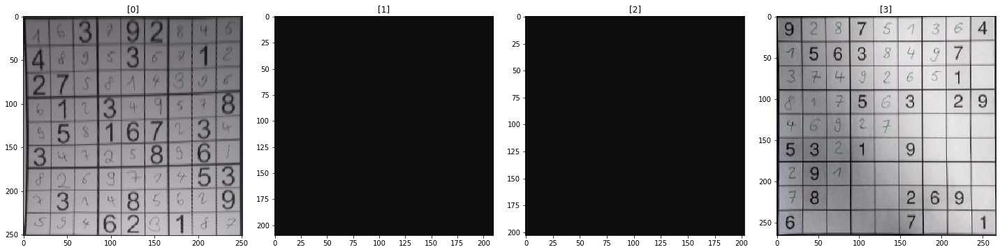

[27/69] Which of these images are valid?03
[27/69] You have selected indices [0, 3] which are mapped to [104, 107]!


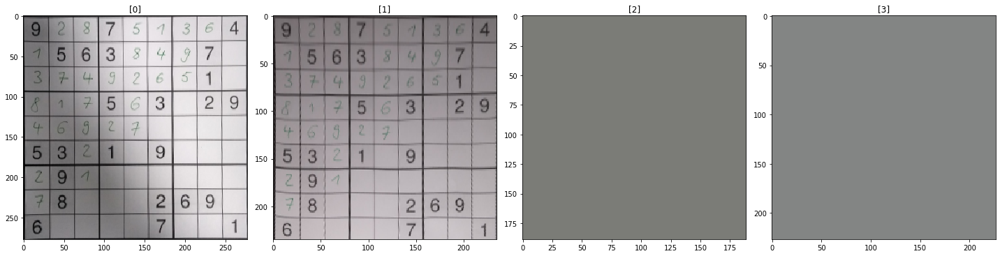

[28/69] Which of these images are valid?01
[28/69] You have selected indices [0, 1] which are mapped to [108, 109]!


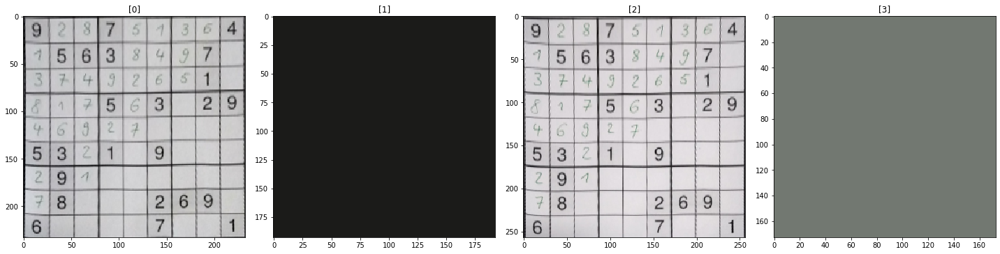

[29/69] Which of these images are valid?02
[29/69] You have selected indices [0, 2] which are mapped to [112, 114]!


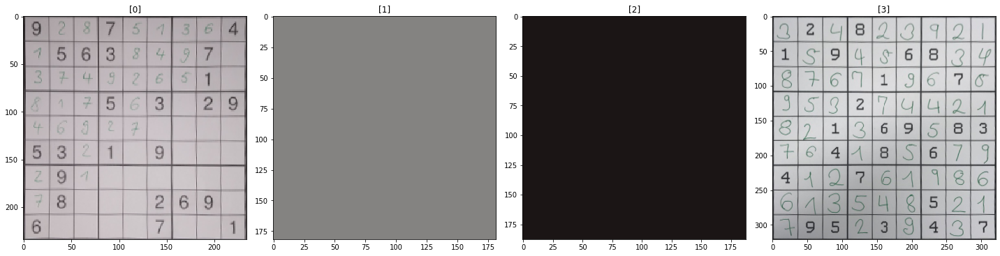

[30/69] Which of these images are valid?03
[30/69] You have selected indices [0, 3] which are mapped to [116, 119]!


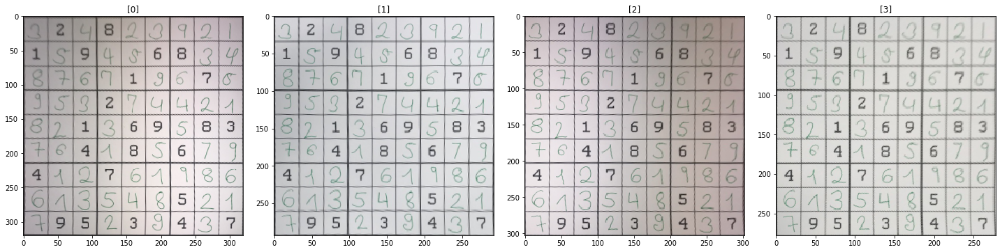

[31/69] Which of these images are valid?0123
[31/69] You have selected indices [0, 1, 2, 3] which are mapped to [120, 121, 122, 123]!


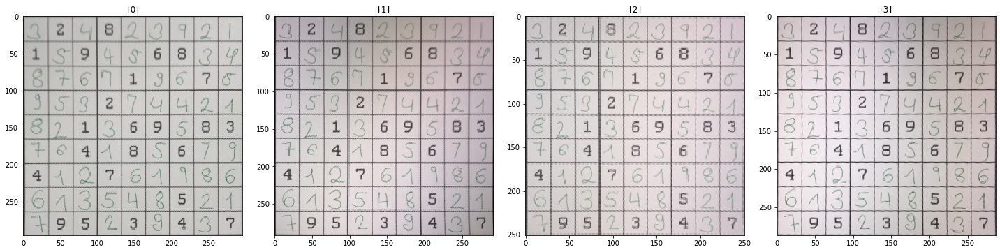

[32/69] Which of these images are valid?0123
[32/69] You have selected indices [0, 1, 2, 3] which are mapped to [124, 125, 126, 127]!


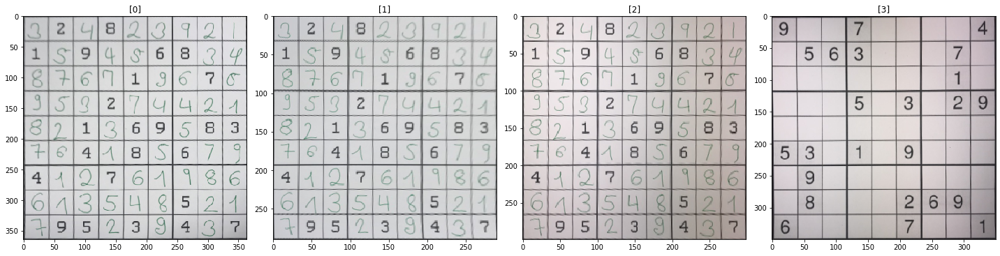

[33/69] Which of these images are valid?0123
[33/69] You have selected indices [0, 1, 2, 3] which are mapped to [128, 129, 130, 131]!


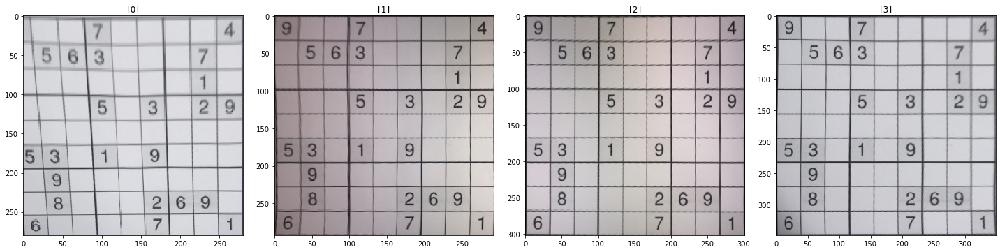

[34/69] Which of these images are valid?123
[34/69] You have selected indices [1, 2, 3] which are mapped to [133, 134, 135]!


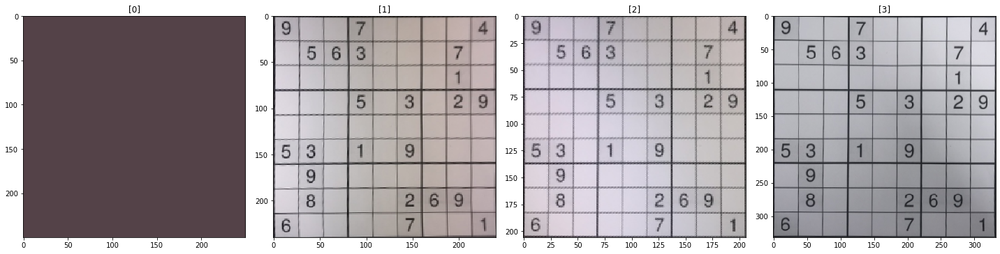

[35/69] Which of these images are valid?123
[35/69] You have selected indices [1, 2, 3] which are mapped to [137, 138, 139]!


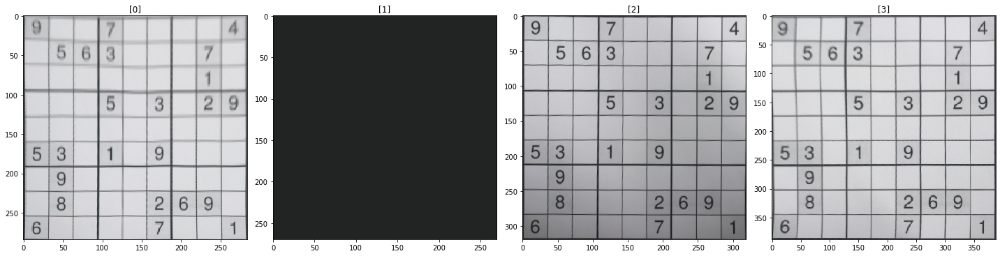

[36/69] Which of these images are valid?023
[36/69] You have selected indices [0, 2, 3] which are mapped to [140, 142, 143]!


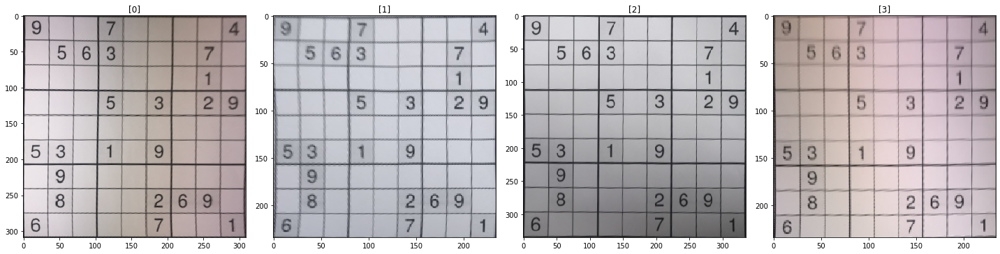

[37/69] Which of these images are valid?0123
[37/69] You have selected indices [0, 1, 2, 3] which are mapped to [144, 145, 146, 147]!


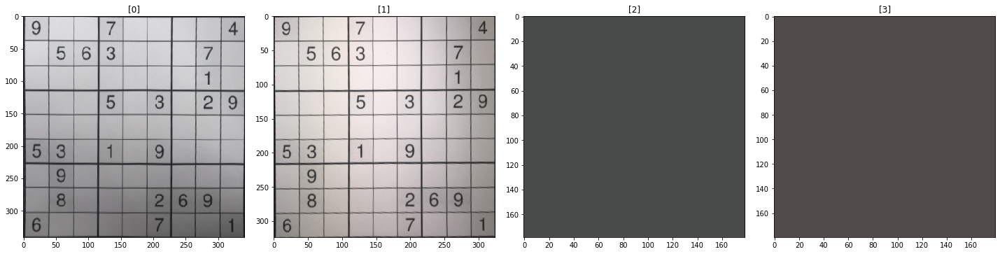

[38/69] Which of these images are valid?01
[38/69] You have selected indices [0, 1] which are mapped to [148, 149]!


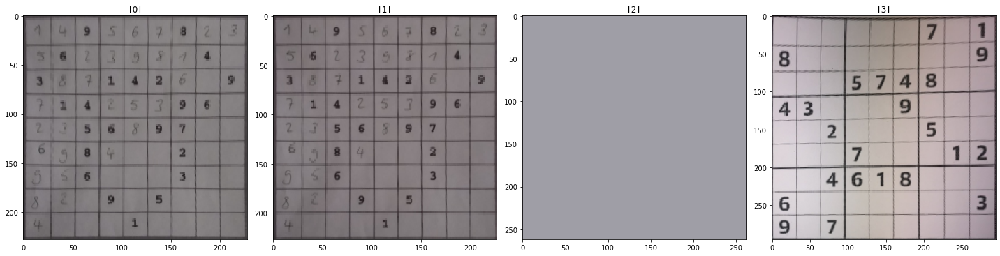

[39/69] Which of these images are valid?013
[39/69] You have selected indices [0, 1, 3] which are mapped to [152, 153, 155]!


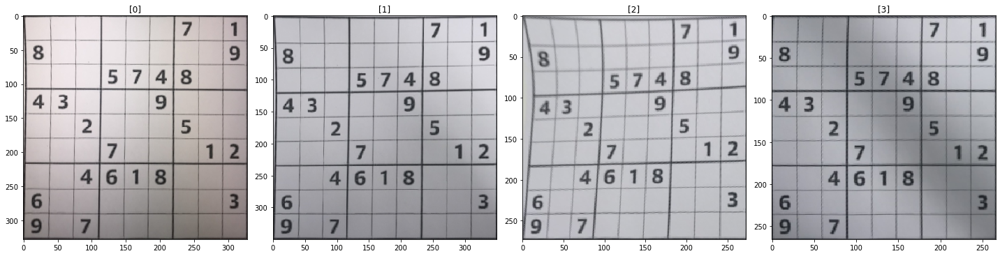

[40/69] Which of these images are valid?0123
[40/69] You have selected indices [0, 1, 2, 3] which are mapped to [156, 157, 158, 159]!


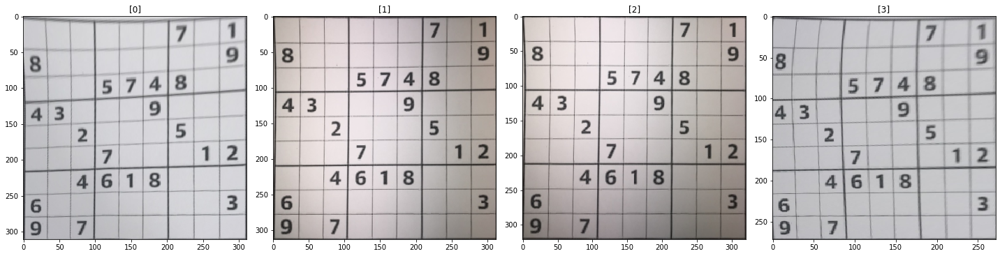

[41/69] Which of these images are valid?0123
[41/69] You have selected indices [0, 1, 2, 3] which are mapped to [160, 161, 162, 163]!


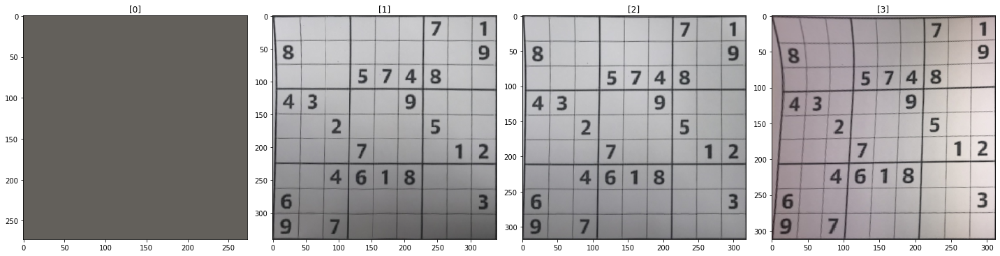

[42/69] Which of these images are valid?123
[42/69] You have selected indices [1, 2, 3] which are mapped to [165, 166, 167]!


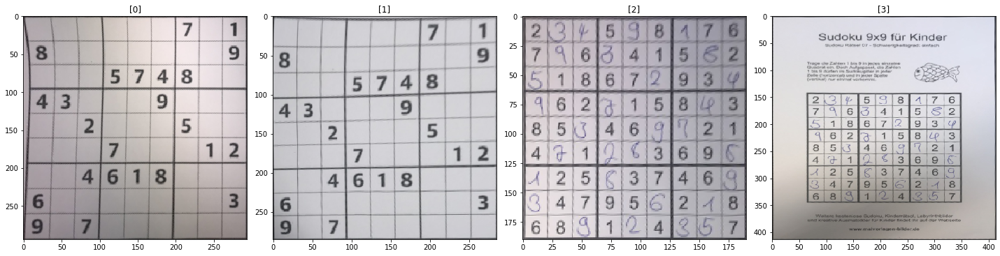

[43/69] Which of these images are valid?012
[43/69] You have selected indices [0, 1, 2] which are mapped to [168, 169, 170]!


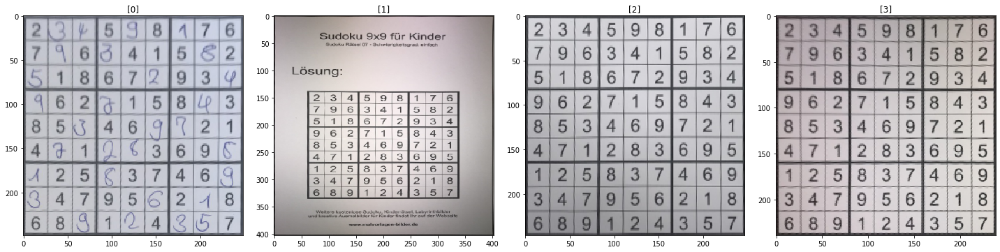

[44/69] Which of these images are valid?023
[44/69] You have selected indices [0, 2, 3] which are mapped to [172, 174, 175]!


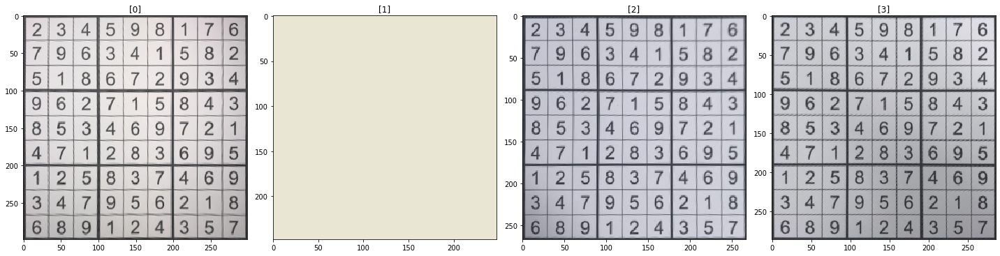

[45/69] Which of these images are valid?023
[45/69] You have selected indices [0, 2, 3] which are mapped to [176, 178, 179]!


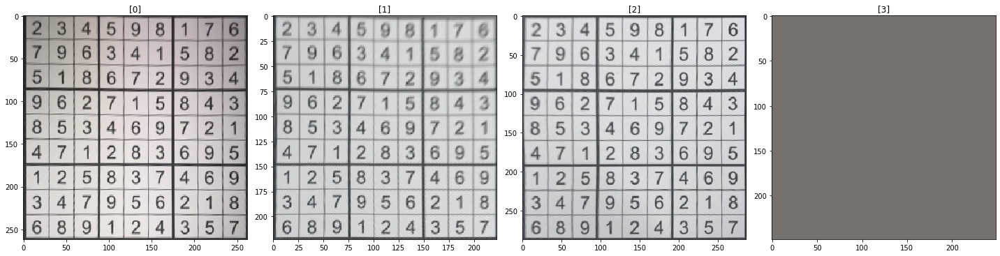

[46/69] Which of these images are valid?012
[46/69] You have selected indices [0, 1, 2] which are mapped to [180, 181, 182]!


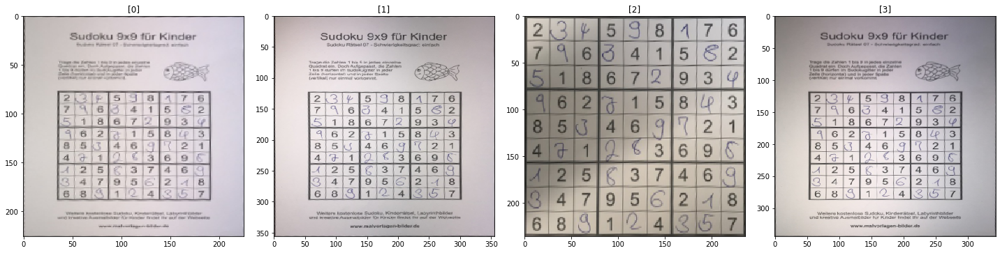

[47/69] Which of these images are valid?2
[47/69] You have selected indices [2] which are mapped to [186]!


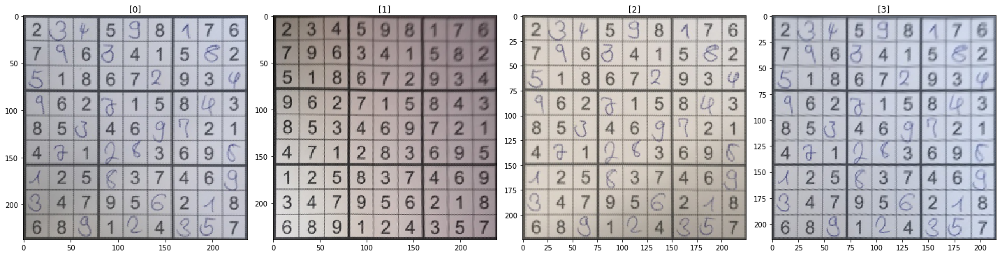

[48/69] Which of these images are valid?0123
[48/69] You have selected indices [0, 1, 2, 3] which are mapped to [188, 189, 190, 191]!


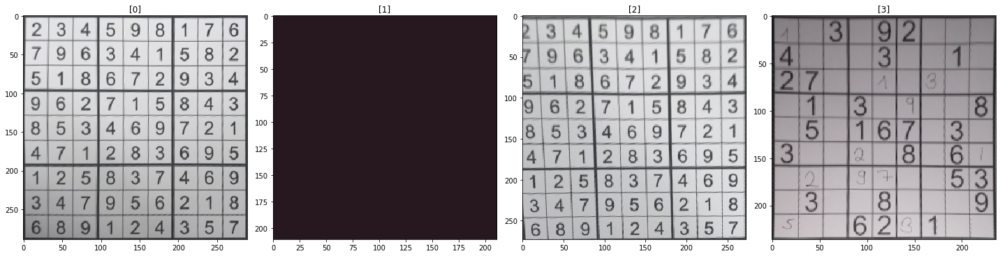

[49/69] Which of these images are valid?03
[49/69] You have selected indices [0, 3] which are mapped to [192, 195]!


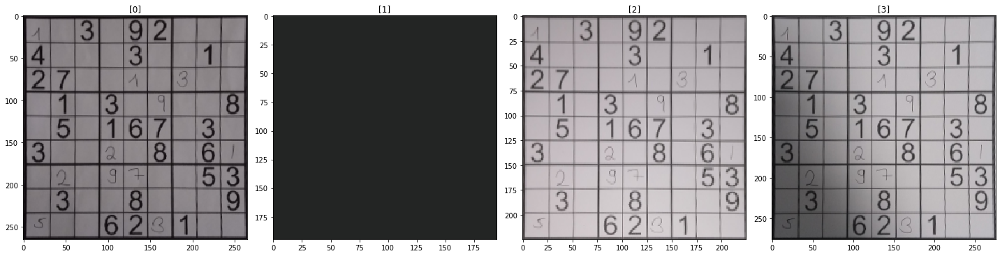

[50/69] Which of these images are valid?023
[50/69] You have selected indices [0, 2, 3] which are mapped to [196, 198, 199]!


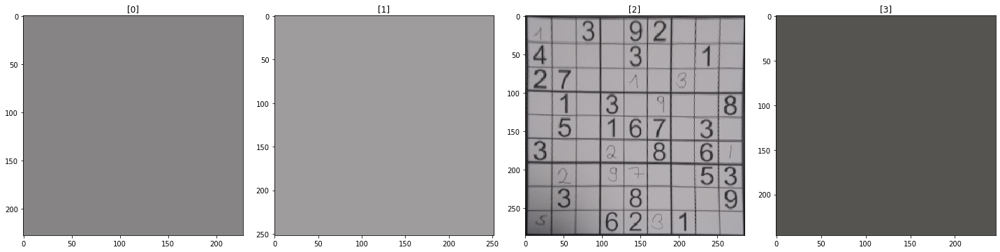

[51/69] Which of these images are valid?2
[51/69] You have selected indices [2] which are mapped to [202]!


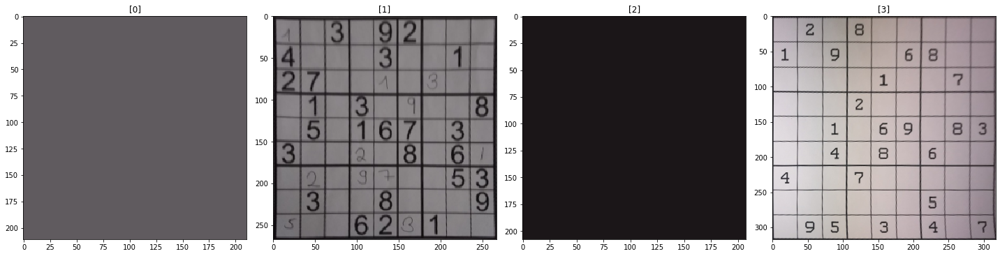

[52/69] Which of these images are valid?13
[52/69] You have selected indices [1, 3] which are mapped to [205, 207]!


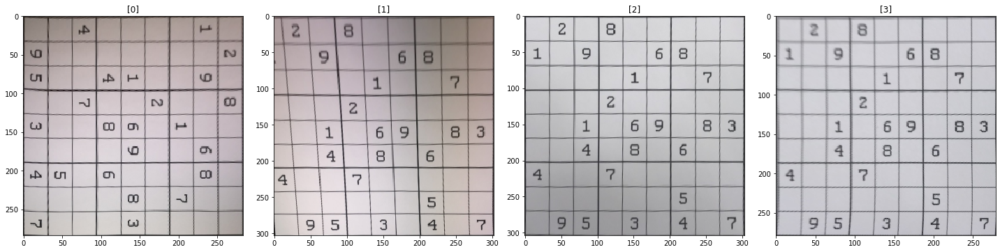

[53/69] Which of these images are valid?23
[53/69] You have selected indices [2, 3] which are mapped to [210, 211]!


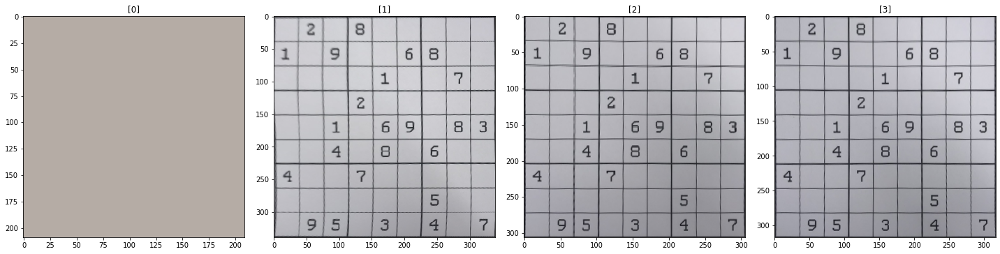

[54/69] Which of these images are valid?123
[54/69] You have selected indices [1, 2, 3] which are mapped to [213, 214, 215]!


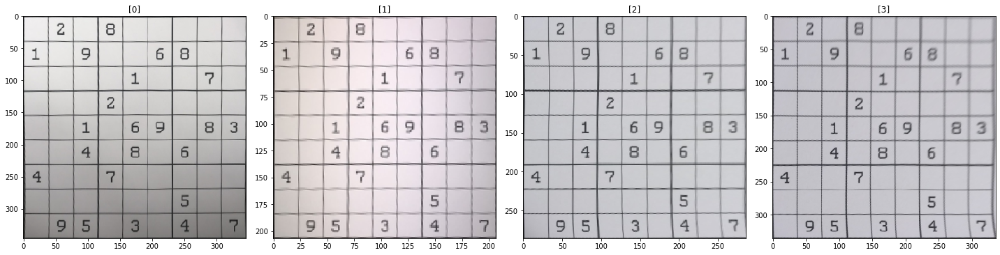

[55/69] Which of these images are valid?0123
[55/69] You have selected indices [0, 1, 2, 3] which are mapped to [216, 217, 218, 219]!


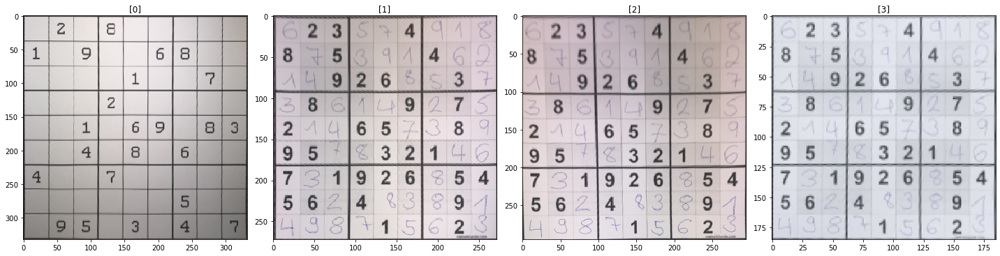

[56/69] Which of these images are valid?0123
[56/69] You have selected indices [0, 1, 2, 3] which are mapped to [220, 221, 222, 223]!


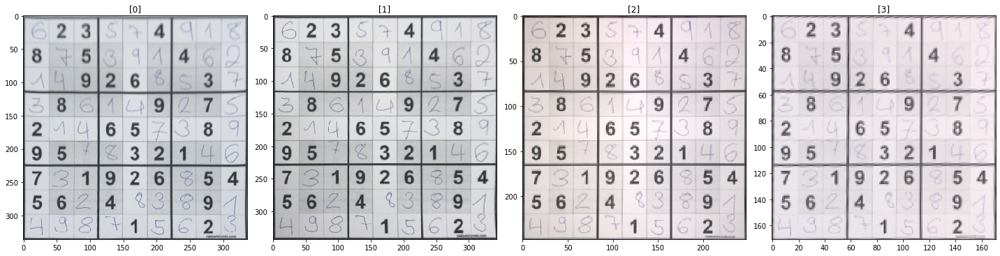

[57/69] Which of these images are valid?0123
[57/69] You have selected indices [0, 1, 2, 3] which are mapped to [224, 225, 226, 227]!


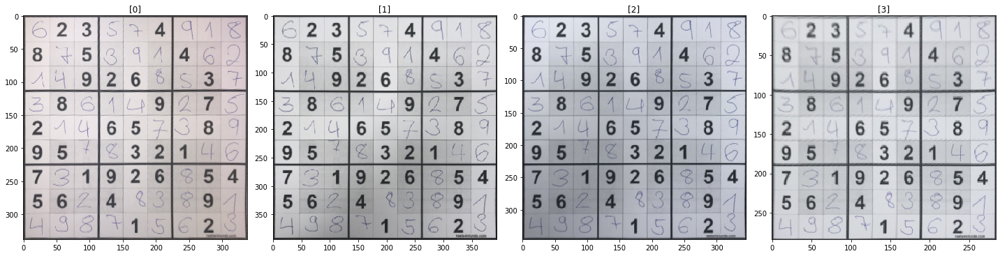

[58/69] Which of these images are valid?0123
[58/69] You have selected indices [0, 1, 2, 3] which are mapped to [228, 229, 230, 231]!


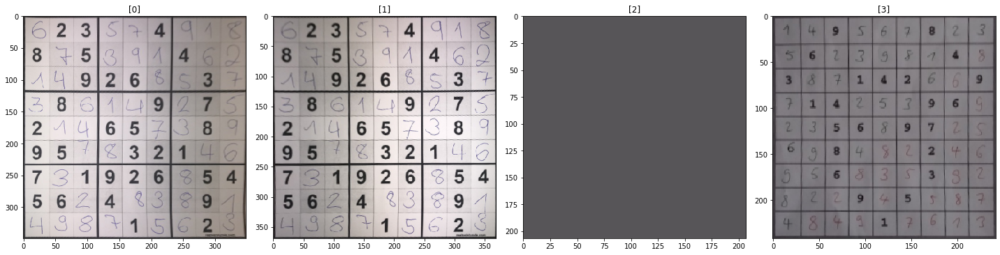

[59/69] Which of these images are valid?013
[59/69] You have selected indices [0, 1, 3] which are mapped to [232, 233, 235]!


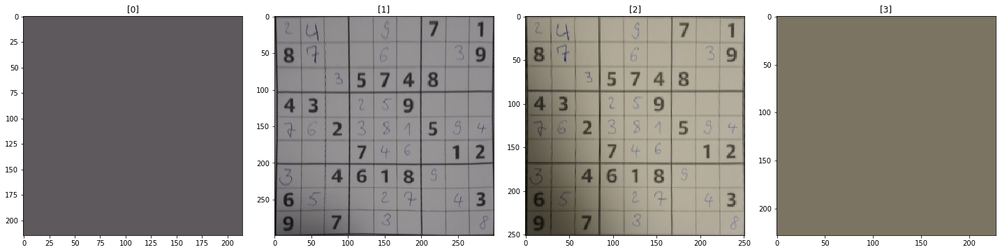

[60/69] Which of these images are valid?12
[60/69] You have selected indices [1, 2] which are mapped to [237, 238]!


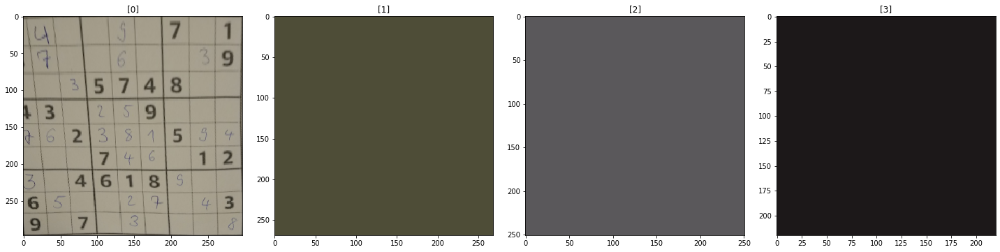

[61/69] Which of these images are valid?
[61/69] You have selected indices [] which are mapped to []!


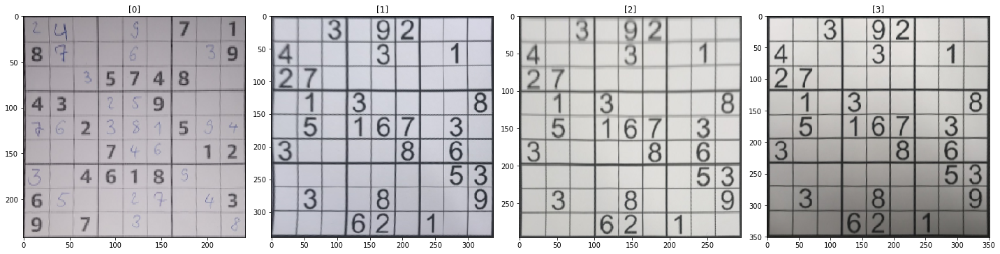

[62/69] Which of these images are valid?0123
[62/69] You have selected indices [0, 1, 2, 3] which are mapped to [244, 245, 246, 247]!


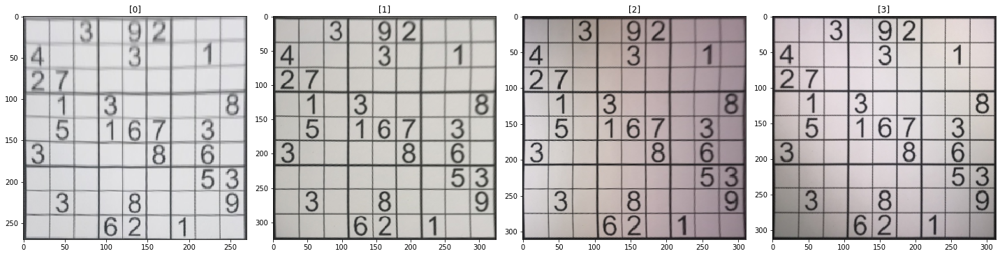

[63/69] Which of these images are valid?0123
[63/69] You have selected indices [0, 1, 2, 3] which are mapped to [248, 249, 250, 251]!


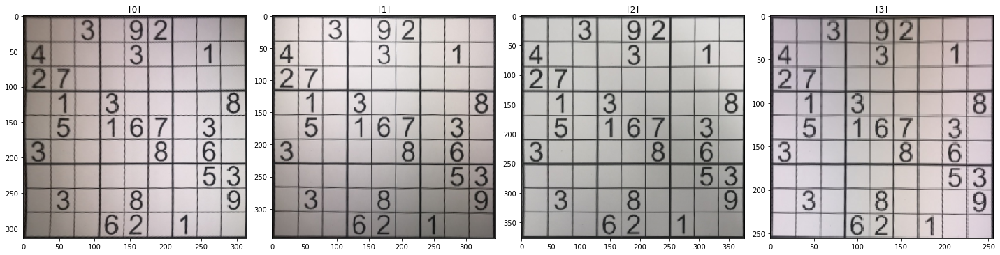

[64/69] Which of these images are valid?0123
[64/69] You have selected indices [0, 1, 2, 3] which are mapped to [252, 253, 254, 255]!


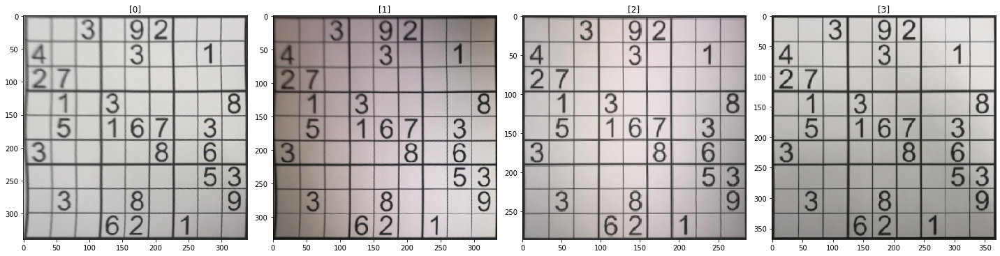

[65/69] Which of these images are valid?0123
[65/69] You have selected indices [0, 1, 2, 3] which are mapped to [256, 257, 258, 259]!


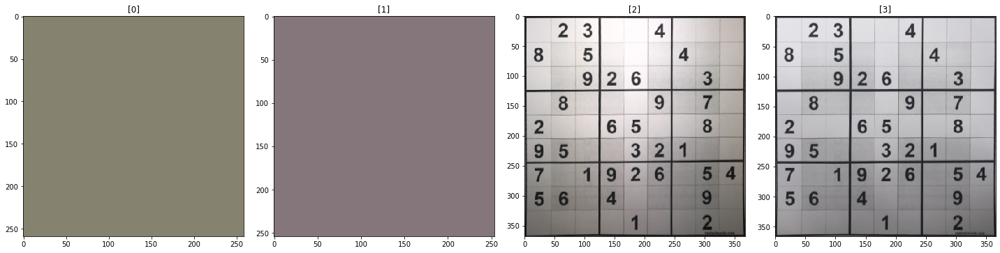

[66/69] Which of these images are valid?23
[66/69] You have selected indices [2, 3] which are mapped to [262, 263]!


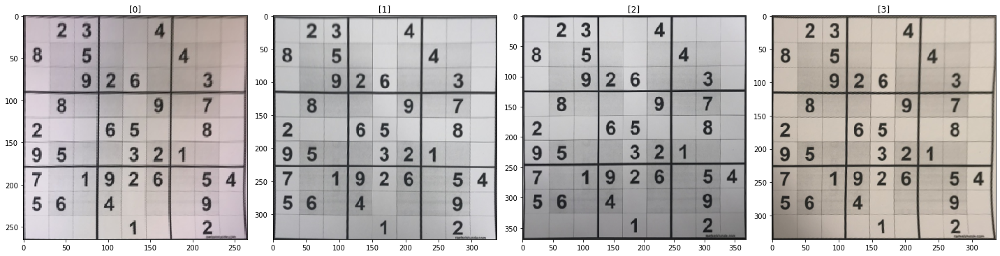

[67/69] Which of these images are valid?0123
[67/69] You have selected indices [0, 1, 2, 3] which are mapped to [264, 265, 266, 267]!


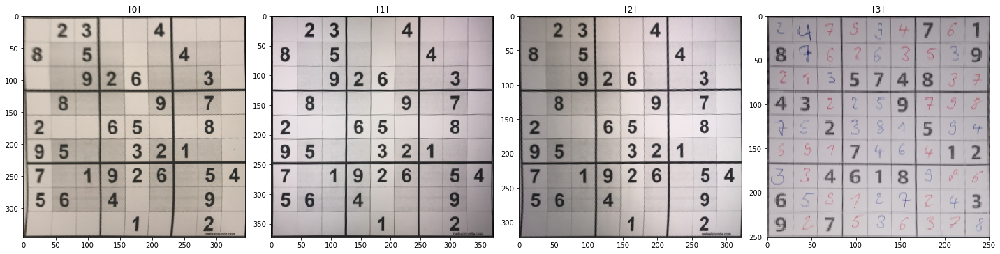

[68/69] Which of these images are valid?0123
[68/69] You have selected indices [0, 1, 2, 3] which are mapped to [268, 269, 270, 271]!


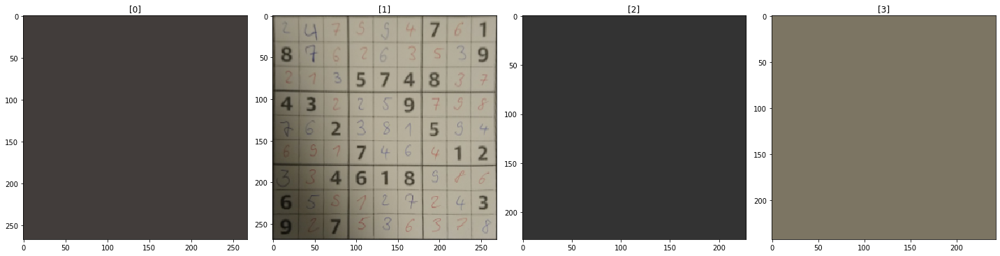

[69/69] Which of these images are valid?1
[69/69] You have selected indices [1] which are mapped to [273]!


In [21]:
indices = np.arange(len(dataset))
n_shown = 4  # number of images to show at once
n_iterations = math.ceil(len(indices) / n_shown)  # number of required iterations
selected_indices = []  # indices that are valid and will be used for further analysis
for i in range(n_iterations):
  subset = indices[i*n_shown:(i+1)*n_shown]  # indices that will be shown in the current iteration
  show_images(dataset["transform_image"][subset], rows=1)
  valid = input("[%d/%d] Which of these images are valid?" % (i + 1, n_iterations))
  valid = re.findall("\d", valid)
  valid = [int(i) for i in valid]
  mapped_valid = [subset[i] for i in valid]  # map local indices (e. g. 0..4) to global indices (e. g. n..n+4)
  print("[%d/%d] You have selected indices %s which are mapped to %s!" % (i + 1, n_iterations, valid, mapped_valid))
  selected_indices.extend(mapped_valid)

In [22]:
dataset_good = dataset.iloc[selected_indices]
print("%d images were selected!" % len(dataset_good))

196 images were selected!


# Export

In [0]:
df = dataset[["transform_contour_source", "transform_contour_target", "transform_matrix", "transform_image"]]

In [25]:
df

,transform_contour_source,transform_contour_target,transform_matrix,transform_image
input_filename,,,,
./v2_train/image1066.jpg,"[[34, 139], [30, 377], [469, 377], [454, 138]]","[[0, 0], [0, 334], [334, 334], [334, 0]]","[[0.8205270679331066, 0.013790370889632036, -2...","[[[95, 93, 91], [84, 81, 80], [79, 76, 75], [7..."
./v2_train/image1087.jpg,"[[56, 79], [51, 374], [475, 368], [446, 79]]","[[0, 0], [0, 349], [349, 349], [349, 0]]","[[0.8969706083700217, 0.01520289166728851, -51...","[[[118, 118, 114], [54, 52, 48], [59, 56, 52],..."
./v2_train/image204.jpg,"[[97, 72], [95, 474], [407, 477], [399, 65]]","[[0, 0], [0, 357], [357, 357], [357, 0]]","[[1.228503379336248, 0.006111957111125652, -11...","[[[85, 79, 47], [70, 64, 35], [66, 60, 34], [6..."
./v2_train/image1075.jpg,"[[58, 117], [56, 427], [479, 418], [457, 112]]","[[0, 0], [0, 359], [359, 359], [359, 0]]","[[0.9091851228978102, 0.00586571047030846, -53...","[[[109, 106, 103], [72, 65, 62], [77, 69, 67],..."
./v2_train/image1078.jpg,"[[62, 123], [53, 395], [430, 392], [422, 118]]","[[0, 0], [0, 320], [320, 320], [320, 0]]","[[0.9172609330645485, 0.030350545579341717, -6...","[[[96, 96, 94], [68, 65, 64], [68, 67, 66], [6..."
...,...,...,...,...
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165410544.jpg,"[[117, 163], [94, 373], [410, 370], [386, 160]]","[[0, 0], [0, 251], [251, 251], [251, 0]]","[[1.0857963643501938, 0.11892055419073555, -14...","[[[90, 85, 89], [90, 85, 89], [93, 88, 92], [9..."
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165338808.jpg,"[[4, 264], [4, 264], [294, 427], [478, 238]]","[[0, 0], [0, 267], [267, 267], [267, 0]]","[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, ...","[[[66, 61, 59], [66, 61, 59], [66, 61, 59], [6..."
./sudoku_dataset_1024/train_247994761_full/IMG_20200115_165329872.jpg,"[[108, 154], [86, 379], [425, 375], [396, 152]]","[[0, 0], [0, 269], [269, 269], [269, 0]]","[[1.0551817592706854, 0.10317332757313367, -12...","[[[96, 90, 76], [56, 50, 37], [63, 57, 44], [7..."


In [0]:
df.to_pickle("./sudoku_transformation_output.bz2")

In [0]:
!cp "./sudoku_transformation_output.bz2" "./drive/My Drive/sudoku_transformation_output.bz2"